In [538]:
#necessary imports
import pandas as pd
import geopandas as gpd
import numpy as np
from pyproj import Proj, transform
import rasterio
from PIL import Image
import matplotlib.pyplot as plt
import cv2
import random

In [539]:
#load final dataset 
final = pd.read_csv('final_dataset.csv') 

In [540]:
final.head()

,img_path,xmin,ymin,xmax,ymax,score,img_name,tile_index,tile_xmin,tile_ymin,...,is_musacea_g,site,X_g,Y_g,updated diameter,group,updated height,AGB,carbon,id
0,Carlos Vera Guevara RGB_3_0_8305_4000_12305.png,3332.557861,19.092411,3661.390137,364.616425,0.531211,Carlos Vera Guevara RGB,3,0,8305,...,1.0,Carlos Vera Guevara RGB,5298.555843,7709.844671,10.281385,banana,0.0,4.293300,1.674387,30
1,Carlos Vera Guevara RGB_3_0_8305_4000_12305.png,3162.579834,2148.233398,3431.632324,2379.467041,0.511510,Carlos Vera Guevara RGB,3,0,8305,...,1.0,Carlos Vera Guevara RGB,5315.345160,8606.745732,13.528139,banana,0.0,7.702971,3.004159,112
2,Carlos Vera Guevara RGB_3_0_8305_4000_12305.png,2893.605713,244.011108,3095.620605,451.257812,0.251310,Carlos Vera Guevara RGB,3,0,8305,...,1.0,Carlos Vera Guevara RGB,5228.142461,7935.770200,12.732366,banana,0.0,6.769828,2.640233,179
3,Carlos Vera Guevara RGB_3_0_8305_4000_12305.png,2595.111084,1703.712402,2765.227295,1865.253418,0.217742,Carlos Vera Guevara RGB,3,0,8305,...,1.0,Carlos Vera Guevara RGB,4434.058601,8354.081799,9.867583,banana,0.0,3.933601,1.534104,93
4,Carlos Vera Guevara RGB_10_7600_7600_11600_116...,249.691879,123.626862,439.557648,302.768402,0.282849,Carlos Vera Guevara RGB,10,7600,7600,...,1.0,Carlos Vera Guevara RGB,8257.952942,7554.538338,17.825312,banana,0.0,13.862143,5.406236,162


In [541]:
final.describe()

,xmin,ymin,xmax,ymax,score,tile_index,tile_xmin,tile_ymin,tile_xmax,tile_ymax,...,year,tree_id,is_musacea_g,X_g,Y_g,updated diameter,updated height,AGB,carbon,id
count,4663.000000,4663.000000,4663.000000,4663.000000,4663.000000,4663.000000,4663.000000,4663.000000,4663.000000,4663.000000,...,4663.000000,4663.000000,4663.000000,4663.000000,4663.000000,4663.000000,4663.000000,4663.000000,4663.000000,4663.000000
mean,1786.694511,1791.680810,2068.869754,2078.698020,0.386675,7.264637,5258.770105,4876.932018,9258.770105,8876.932018,...,2016.990564,146.271713,0.322539,7576.838368,6546.210331,9.251859,2.821102,13.041779,5.086294,234.746515
std,1124.145885,1118.824132,1123.731353,1124.067341,0.135369,4.854366,3847.221231,3382.289628,3847.221231,3382.289628,...,0.985261,203.643468,0.467498,2239.344659,1964.451886,4.931596,36.944663,54.505322,21.257076,167.281493
min,0.000000,0.000000,107.836571,109.524689,0.200119,0.000000,0.000000,0.000000,4000.000000,4000.000000,...,2016.000000,0.000000,0.000000,1988.220761,1884.593530,0.318309,0.000000,0.003780,0.001474,0.000000
25%,820.834656,834.636902,1112.384766,1123.100159,0.268605,4.000000,3800.000000,3800.000000,7800.000000,7800.000000,...,2016.000000,0.000000,0.000000,5877.062136,5063.183876,6.111536,0.000000,4.493912,1.752626,97.000000
50%,1741.220947,1757.494263,2049.079346,2040.152710,0.363504,6.000000,3800.000000,3800.000000,7800.000000,7800.000000,...,2017.000000,0.000000,0.000000,7415.304527,6500.260538,7.957729,0.000000,7.121503,2.777386,204.000000
75%,2721.508423,2735.388672,2998.063477,3035.515015,0.486236,10.000000,7600.000000,7600.000000,11600.000000,11600.000000,...,2018.000000,397.000000,1.000000,9152.983965,7956.914830,11.936593,0.000000,11.054551,4.311275,346.000000
max,3895.628174,3891.397217,4000.000000,4000.000000,0.829151,22.000000,13134.000000,11578.000000,17134.000000,15578.000000,...,2019.000000,543.000000,1.000000,14021.142013,12445.658258,67.799847,2003.000000,2138.064467,833.845142,746.000000


In [542]:
#seeing how many I would lose if I only use the ones with diameters 
final[final['diameter'] > 0].shape[0]/final.shape[0]

0.562084494960326

56% of the data is not great, but I also think it is important to have accurate DBH for what I am doing. 

In [543]:
final_sm = final[final['diameter'] > 0]

In [544]:
final_sm

,img_path,xmin,ymin,xmax,ymax,score,img_name,tile_index,tile_xmin,tile_ymin,...,is_musacea_g,site,X_g,Y_g,updated diameter,group,updated height,AGB,carbon,id
0,Carlos Vera Guevara RGB_3_0_8305_4000_12305.png,3332.557861,19.092411,3661.390137,364.616425,0.531211,Carlos Vera Guevara RGB,3,0,8305,...,1.0,Carlos Vera Guevara RGB,5298.555843,7709.844671,10.281385,banana,0.0,4.293300,1.674387,30
1,Carlos Vera Guevara RGB_3_0_8305_4000_12305.png,3162.579834,2148.233398,3431.632324,2379.467041,0.511510,Carlos Vera Guevara RGB,3,0,8305,...,1.0,Carlos Vera Guevara RGB,5315.345160,8606.745732,13.528139,banana,0.0,7.702971,3.004159,112
2,Carlos Vera Guevara RGB_3_0_8305_4000_12305.png,2893.605713,244.011108,3095.620605,451.257812,0.251310,Carlos Vera Guevara RGB,3,0,8305,...,1.0,Carlos Vera Guevara RGB,5228.142461,7935.770200,12.732366,banana,0.0,6.769828,2.640233,179
3,Carlos Vera Guevara RGB_3_0_8305_4000_12305.png,2595.111084,1703.712402,2765.227295,1865.253418,0.217742,Carlos Vera Guevara RGB,3,0,8305,...,1.0,Carlos Vera Guevara RGB,4434.058601,8354.081799,9.867583,banana,0.0,3.933601,1.534104,93
4,Carlos Vera Guevara RGB_10_7600_7600_11600_116...,249.691879,123.626862,439.557648,302.768402,0.282849,Carlos Vera Guevara RGB,10,7600,7600,...,1.0,Carlos Vera Guevara RGB,8257.952942,7554.538338,17.825312,banana,0.0,13.862143,5.406236,162
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4645,Nestor Macias RGB_3_0_9024_4000_13024.png,2664.345215,232.421860,2992.793945,577.599243,0.401987,Nestor Macias RGB,3,0,9024,...,0.0,Nestor Macias RGB,5083.016310,8395.427219,8.404929,other,0.0,16.643291,6.490884,167
4650,Nestor Macias RGB_3_0_9024_4000_13024.png,3003.697266,15.084885,3288.265381,276.357574,0.356021,Nestor Macias RGB,3,0,9024,...,0.0,Nestor Macias RGB,5232.131207,8130.712274,8.785332,fruit,0.0,24.072524,9.388284,108
4652,Nestor Macias RGB_3_0_9024_4000_13024.png,2624.353027,7.873686,2908.305420,132.604980,0.240188,Nestor Macias RGB,3,0,9024,...,0.0,Nestor Macias RGB,5162.918189,8152.987700,8.359419,cacao,2.2,8.090504,3.155296,162
4657,Nestor Macias RGB_10_7600_7600_11600_11600.png,1168.633789,1419.221558,1340.020508,1599.804932,0.455914,Nestor Macias RGB,10,7600,7600,...,0.0,Nestor Macias RGB,9463.438380,8020.578424,5.220658,cacao,1.5,3.185392,1.242303,500


## Comparing differences between field_data and field_data_sm

In [545]:
species_rep_before = final['name'].value_counts()

In [546]:
species_rep_after = final_sm['name'].value_counts()

In [547]:
#combining the two dataframes into a single one

compare_df = pd.DataFrame({'species_rep_before': species_rep_before, 'species_rep_after': species_rep_after}).fillna(0)
#add a column with the percentage of species lost
compare_df['percentage_lost'] = (compare_df['species_rep_before'] - compare_df['species_rep_after'])/compare_df['species_rep_before']
#refactor percentage_lost to be a percentage and round to 2 decimal places
compare_df['percentage_lost'] = round(compare_df['percentage_lost']*100, 2)

#make species_rep_after an integer
compare_df['species_rep_after'] = compare_df['species_rep_after'].astype(int)

#sort the table by highest species after 
compare_df = compare_df.sort_values(by='species_rep_after', ascending=False)

In [548]:
compare_df

,species_rep_before,species_rep_after,percentage_lost
name,,,
Musacea,1504,1480,1.60
Guaba,597,527,11.73
Cacao,2042,236,88.44
Mango,89,83,6.74
Otra variedad,86,81,5.81
Variedad bifurcada,72,72,0.00
Roble,27,25,7.41
Fernan Sanchez,24,16,33.33
Melina,18,16,11.11


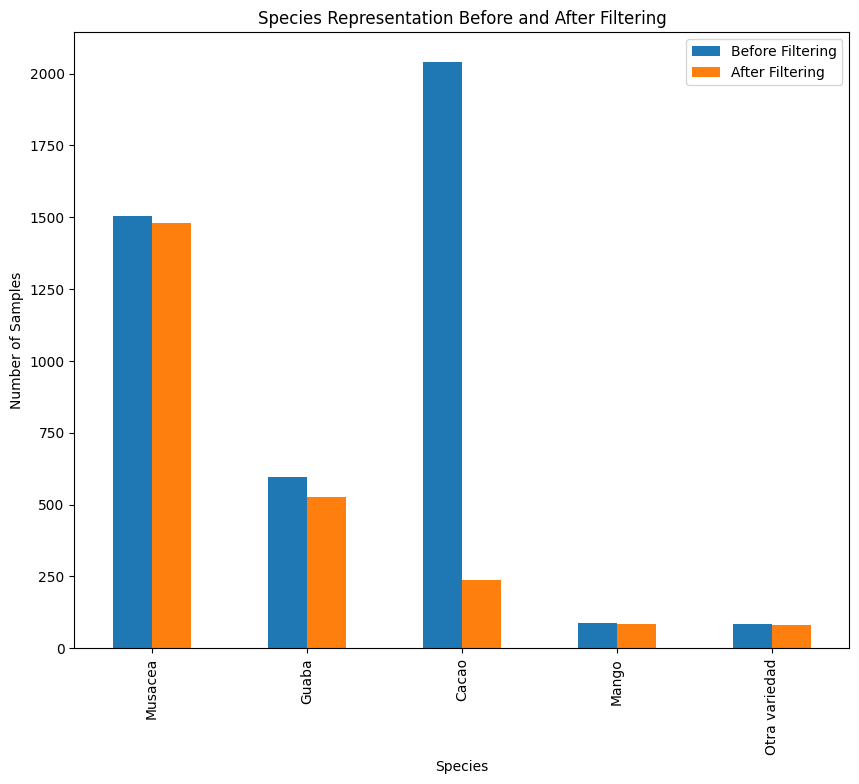

In [549]:
# Plotting the species representation before and after filtering

#only do the top 5 species
compare_df_plot = compare_df.head(5)
compare_df_plot[['species_rep_before', 'species_rep_after']].plot(kind='bar', figsize=(10, 8))
plt.title('Species Representation Before and After Filtering')
plt.xlabel('Species')
plt.ylabel('Number of Samples')
plt.xticks(rotation=90)
plt.legend(['Before Filtering', 'After Filtering'])
plt.show()


With this culling, we have lost three of the species entirely and we have lost 88% of the Cacao data. 

## Visualizing some of the bounding boxes 

In [550]:
def draw_bounding_boxes(image_path, bounding_boxes):
    # Load the image
    image = cv2.imread(image_path)
    if image is None:
        print(f"Image at {image_path} could not be loaded.")
        return None
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # Draw each bounding box
    for bbox in bounding_boxes:
        xmin, ymin, xmax, ymax = bbox['xmin'], bbox['ymin'], bbox['xmax'], bbox['ymax']
        cv2.rectangle(image, (int(xmin), int(ymin)), (int(xmax), int(ymax)), (255, 0, 0), 10)
    
    return image

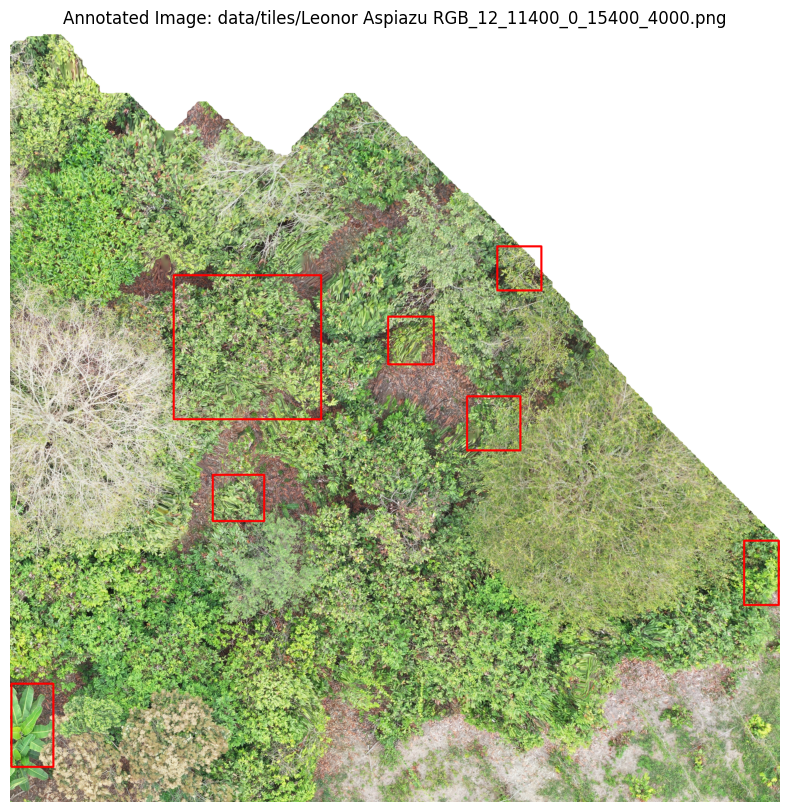

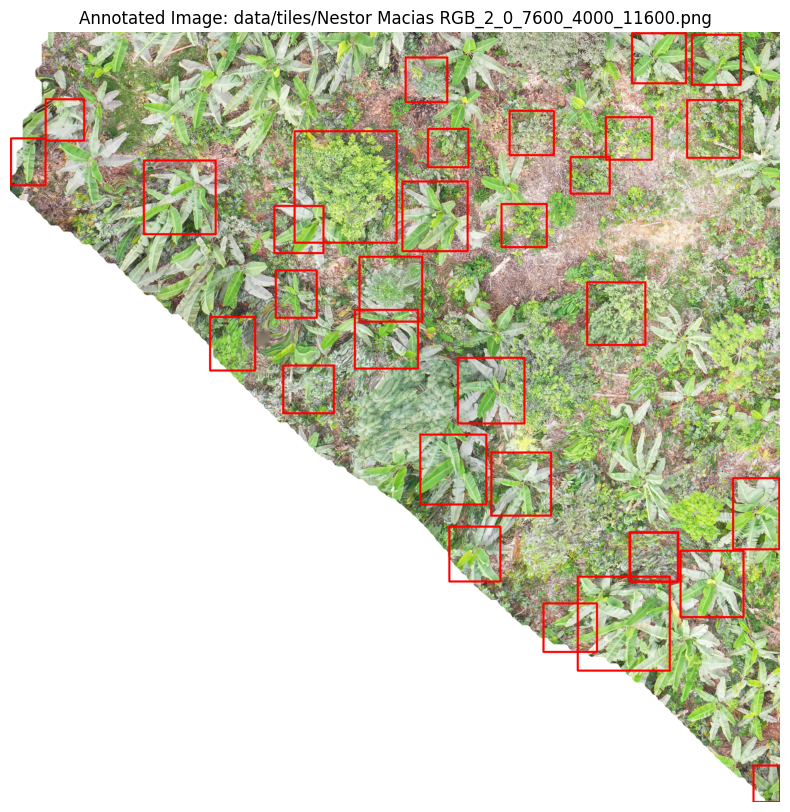

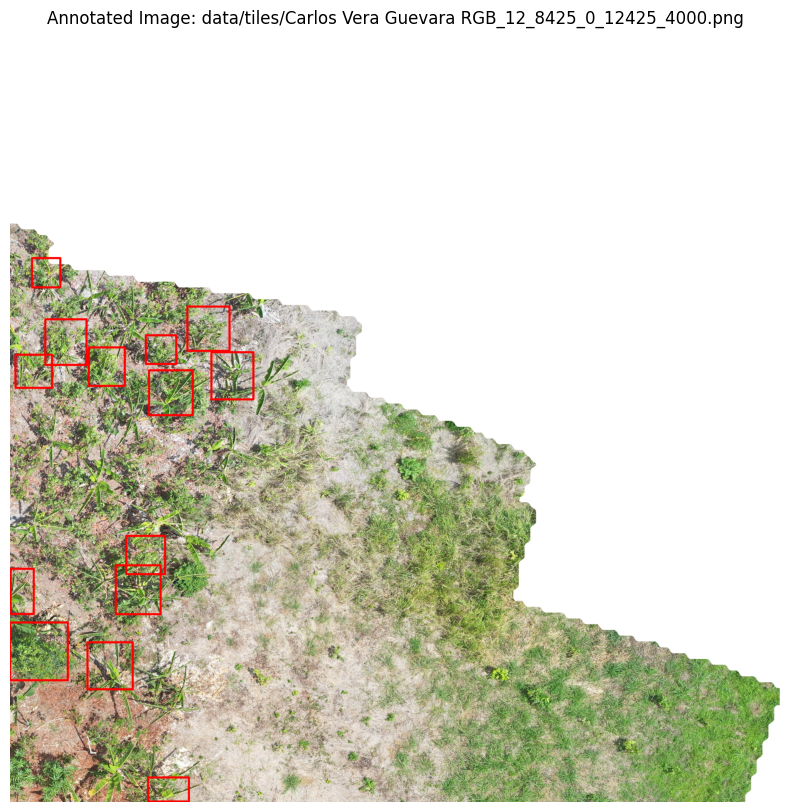

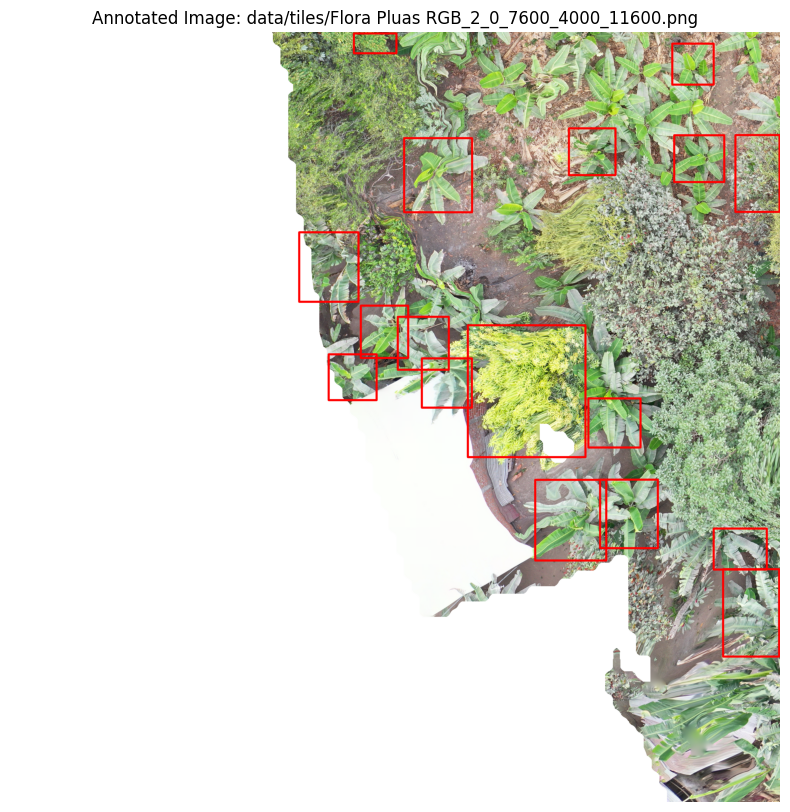

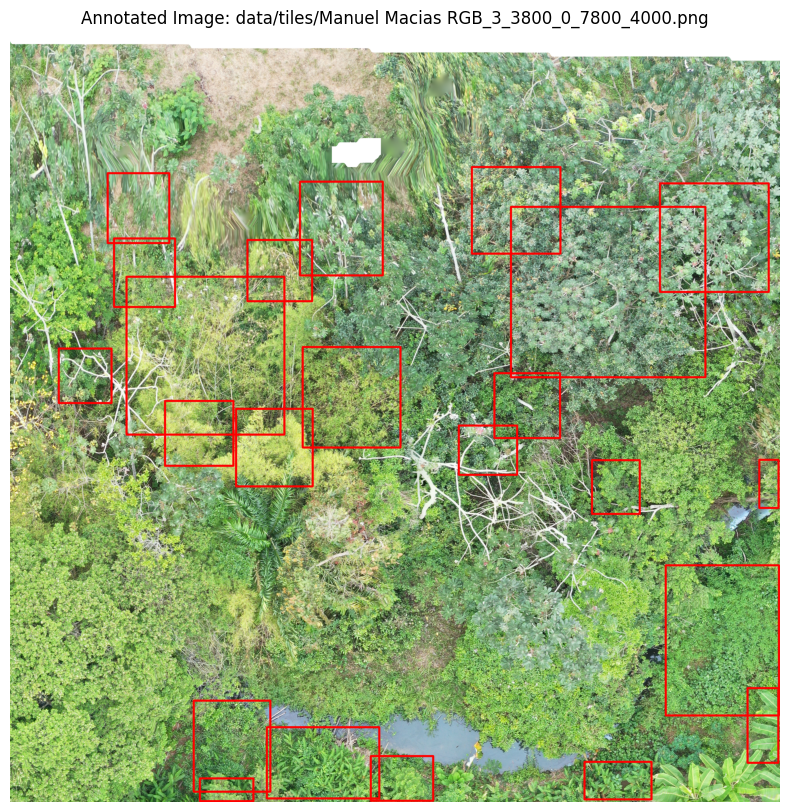

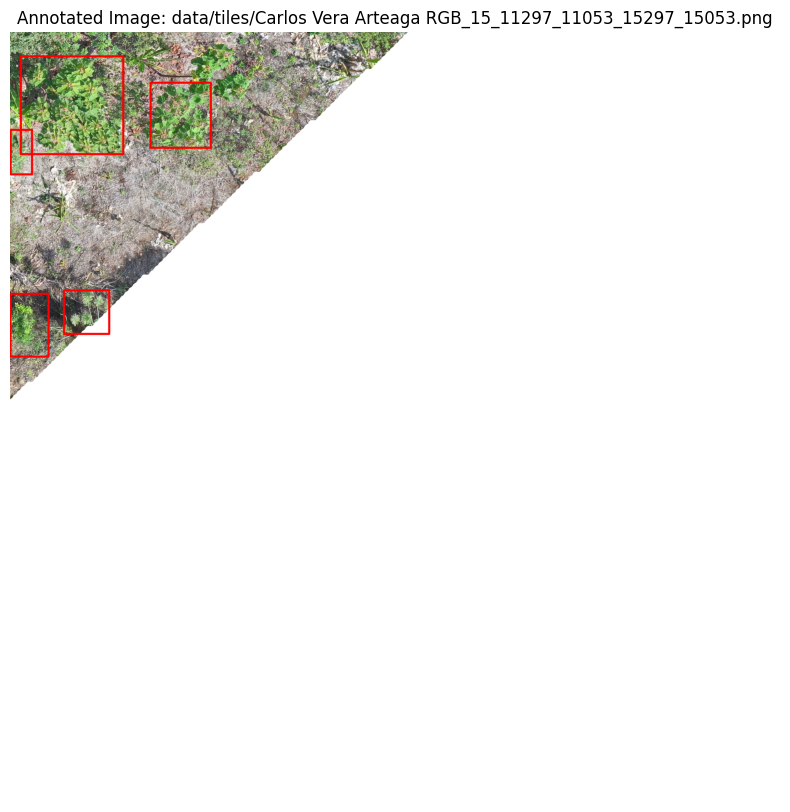

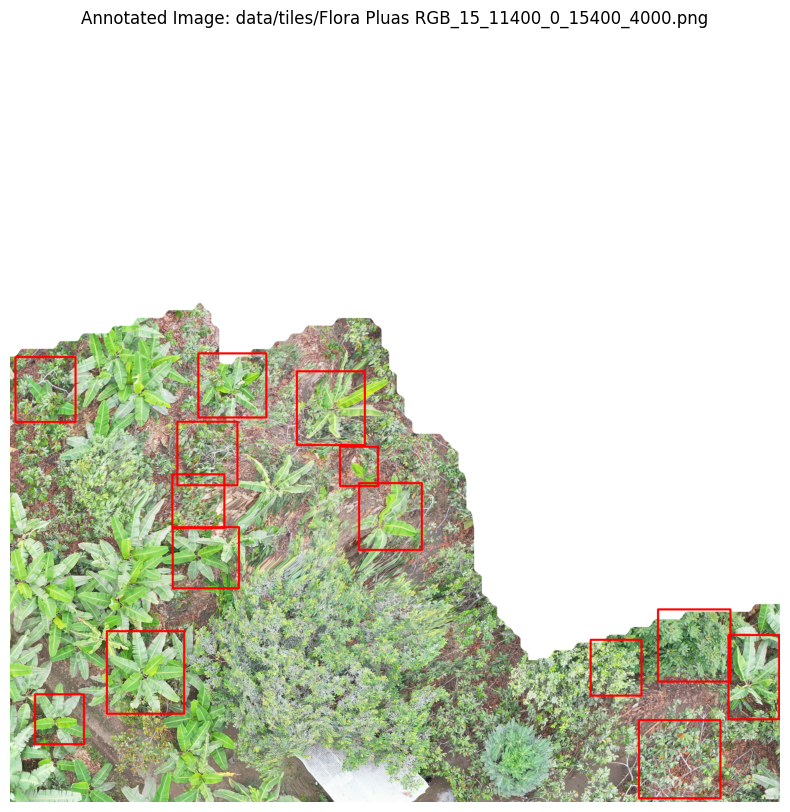

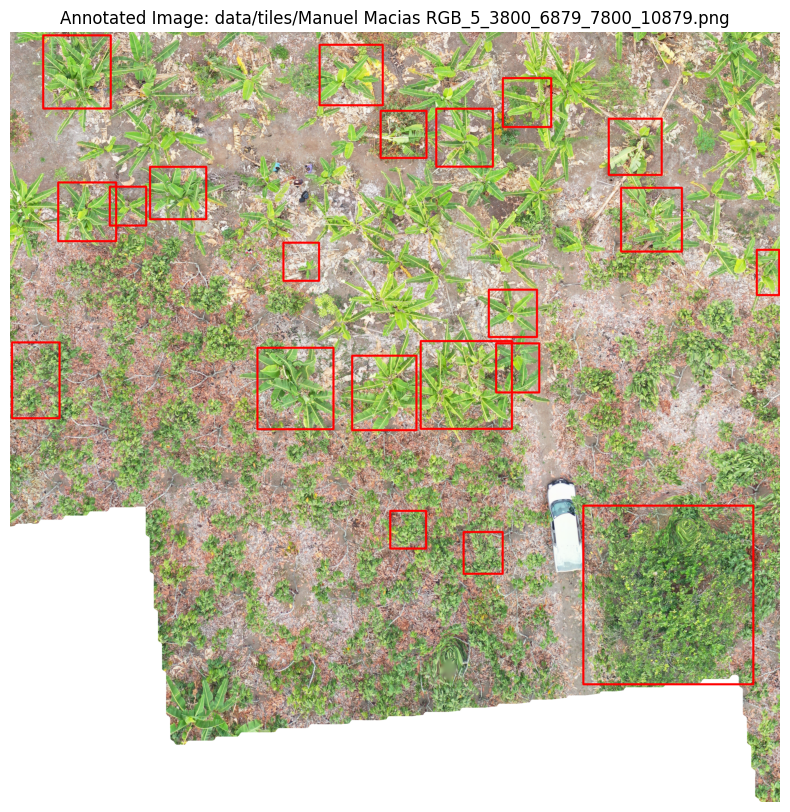

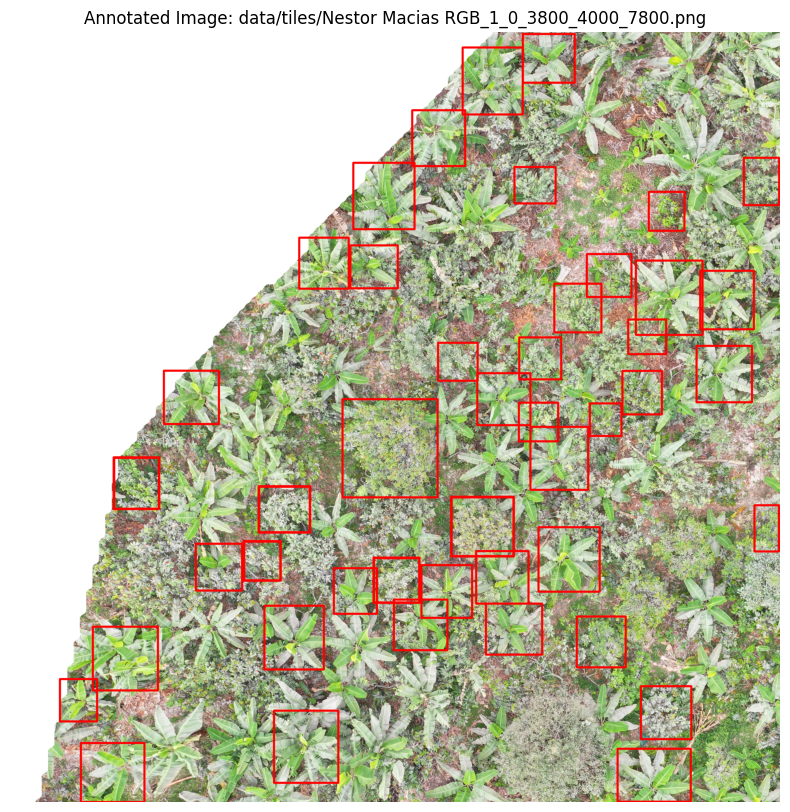

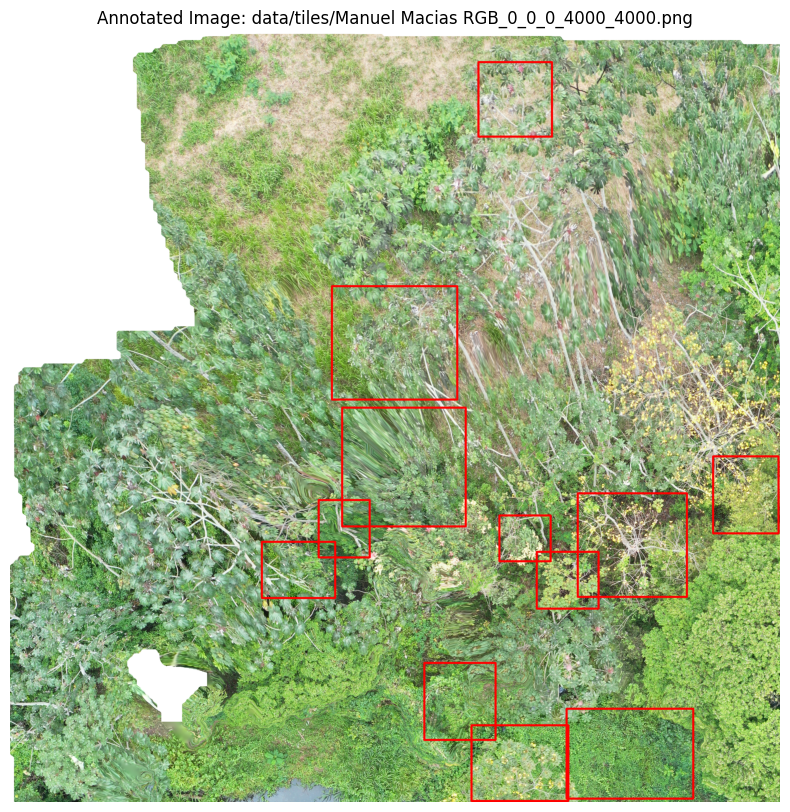

In [551]:
# Group the data by image
grouped = final_sm.groupby('img_path')

# Randomly sample 10 groups
sampled_groups = random.sample(list(grouped), 10)

# Iterate over each sampled group (each image) and draw bounding boxes
for img_path, group in sampled_groups:
    # Construct the full image path
    img_path = 'data/tiles/' + img_path
    
    bounding_boxes = group[['xmin', 'ymin', 'xmax', 'ymax']].to_dict('records')
    annotated_image = draw_bounding_boxes(img_path, bounding_boxes)
    
    if annotated_image is not None:
        # Display the image with bounding boxes
        plt.figure(figsize=(10, 10))
        plt.imshow(annotated_image)
        plt.title(f"Annotated Image: {img_path}")
        plt.axis('off')
        plt.show()

## Image Enhancement

### Metrics for evaluating effectiveness of enhancements

In [552]:
def calculate_brightness(img):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    return np.mean(gray)

def calculate_contrast(img):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    return np.std(gray)

def calculate_edge_intensity(img):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    edges = cv2.Canny(gray, 100, 200)
    return np.sum(edges) / 255

In [553]:
#calculate metrics for an image
def calculate_metrics(img):
    
    brightness = calculate_brightness(img)
    contrast = calculate_contrast(img)
    edge_intensity = calculate_edge_intensity(img)
    
    return {
        'brightness': brightness,
        'contrast': contrast,
        'edge_intensity': edge_intensity
    }

In [554]:
test_image_path = '/Users/ger23/Documents/EDSML/IRP/ReforesTree/data/tiles/Flora Pluas RGB_9_3800_11578_7800_15578.png'

In [555]:
test_image = cv2.imread(test_image_path)

In [556]:
#Baseline metrics for the test image
baseline_metrics = calculate_metrics(test_image)
baseline_metrics

{'brightness': 178.3105091875,
 'contrast': 54.49212693689779,
 'edge_intensity': 2115309.0}

### Contrast

In [557]:
#This uses the CLAHE approach, which is a contrast enhancement technique that uses the histogram of the image to improve the contrast of the image.
def clahe(img):
    # Convert to LAB color space
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    
    # Apply CLAHE to the L-channel
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8,8))
    cl = clahe.apply(l)
    
    # Merge the CLAHE enhanced L-channel with a and b channels
    limg = cv2.merge((cl,a,b))
    
    # Convert LAB image back to color (RGB)
    enhanced_img = cv2.cvtColor(limg, cv2.COLOR_LAB2BGR)

    return enhanced_img

In [558]:
# Display the original and enhanced image
def display_images(img, enhanced_img, title, original_title='Original Image'):
    plt.figure(figsize=(10, 10))
    plt.subplot(1, 2, 1)
    plt.title(original_title)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.subplot(1, 2, 2)
    plt.title(title)
    plt.imshow(cv2.cvtColor(enhanced_img, cv2.COLOR_BGR2RGB))
    plt.show()

    #also print the metrics for the enhanced image
    print("Original Metrics:")
    print(baseline_metrics)
    enhanced_metrics = calculate_metrics(enhanced_img)
    print("Enhanced Metrics:")
    print(enhanced_metrics)

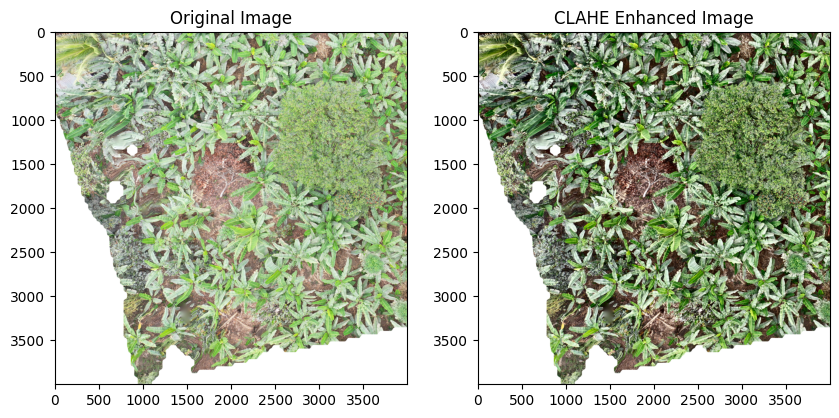

Original Metrics:
{'brightness': 178.3105091875, 'contrast': 54.49212693689779, 'edge_intensity': 2115309.0}
Enhanced Metrics:
{'brightness': 145.4155628125, 'contrast': 81.02149935965379, 'edge_intensity': 2605514.0}


In [559]:
clahe_image = clahe(test_image)
display_images(test_image, clahe_image, 'CLAHE Enhanced Image')

In [560]:
#perform histogram equalization
def equalize_histogram(img):
    ycrcb = cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)
    y, cr, cb = cv2.split(ycrcb)
    y_eq = cv2.equalizeHist(y)
    ycrcb_eq = cv2.merge((y_eq, cr, cb))
    img_eq = cv2.cvtColor(ycrcb_eq, cv2.COLOR_YCrCb2BGR)

    return img_eq
    

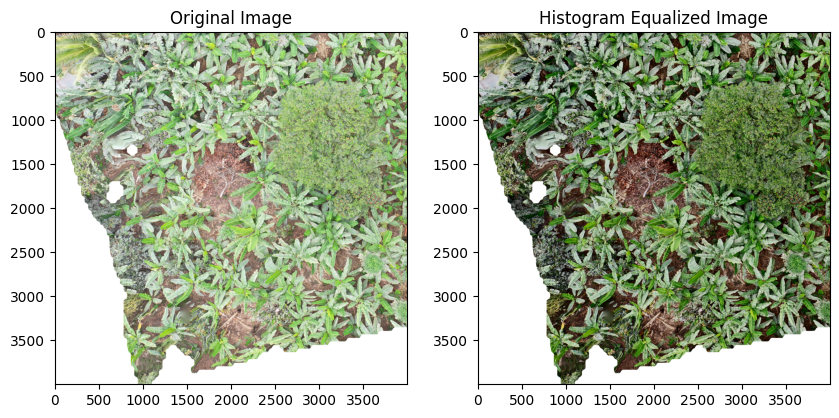

Original Metrics:
{'brightness': 178.3105091875, 'contrast': 54.49212693689779, 'edge_intensity': 2115309.0}
Enhanced Metrics:
{'brightness': 132.162860875, 'contrast': 78.98173485503087, 'edge_intensity': 2372809.0}


In [561]:
histo = equalize_histogram(test_image)
display_images(test_image, histo, 'Histogram Equalized Image')

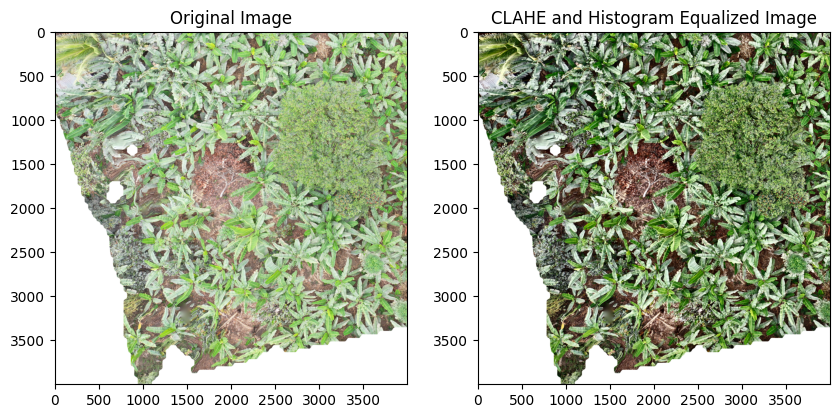

Original Metrics:
{'brightness': 178.3105091875, 'contrast': 54.49212693689779, 'edge_intensity': 2115309.0}
Enhanced Metrics:
{'brightness': 141.5060433125, 'contrast': 83.10483960473276, 'edge_intensity': 2603743.0}


In [562]:
both = clahe(img = histo)
display_images(test_image, both, 'CLAHE and Histogram Equalized Image')

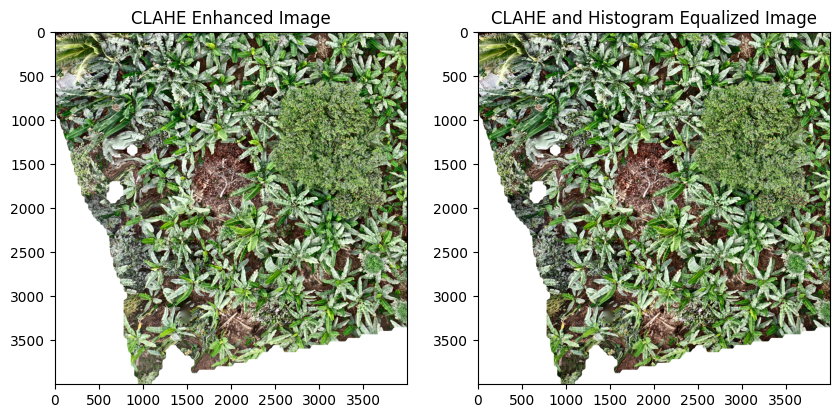

Original Metrics:
{'brightness': 178.3105091875, 'contrast': 54.49212693689779, 'edge_intensity': 2115309.0}
Enhanced Metrics:
{'brightness': 141.5060433125, 'contrast': 83.10483960473276, 'edge_intensity': 2603743.0}


In [563]:
display_images(clahe_image, both, 'CLAHE and Histogram Equalized Image', original_title='CLAHE Enhanced Image')

### Brightness

In [564]:
#function to apply gamma correction 

def gamma_correction(img, gamma = 1.0):
    inv_gamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** inv_gamma) * 255 for i in np.arange(0, 256)]).astype("uint8")
    corrected_img = cv2.LUT(img, table)

    return corrected_img

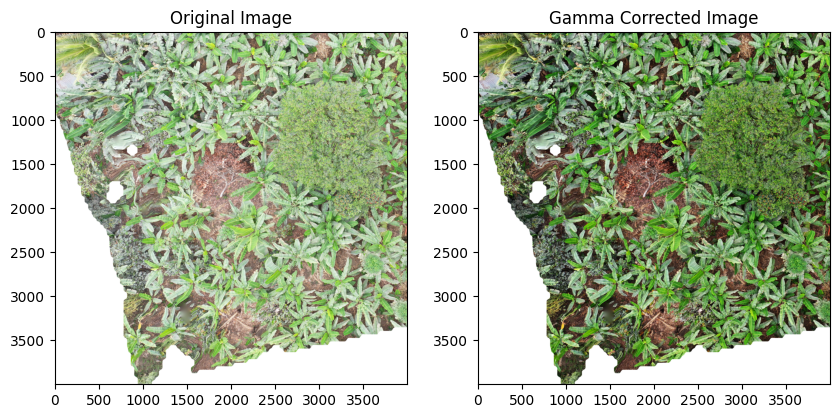

Original Metrics:
{'brightness': 178.3105091875, 'contrast': 54.49212693689779, 'edge_intensity': 2115309.0}
Enhanced Metrics:
{'brightness': 137.10326425, 'contrast': 73.83354168326667, 'edge_intensity': 2304231.0}


In [565]:
gamma = gamma_correction(test_image, gamma=0.5) 
display_images(test_image, gamma, 'Gamma Corrected Image')

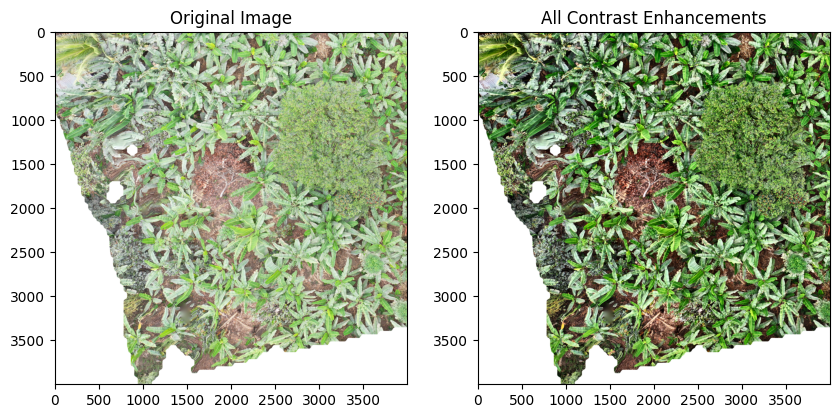

Original Metrics:
{'brightness': 178.3105091875, 'contrast': 54.49212693689779, 'edge_intensity': 2115309.0}
Enhanced Metrics:
{'brightness': 140.0602168125, 'contrast': 82.49044817582215, 'edge_intensity': 2594145.0}


In [566]:
histo = equalize_histogram(img = gamma)
everything = clahe(img = histo)
display_images(test_image, everything, 'All Contrast Enhancements')

In [567]:
#function for linear contrast stretching 
def linear_contrast_stretching(img, alpha = 1.0, beta = 0):
    stretched_img = cv2.convertScaleAbs(img, alpha=alpha, beta=beta)
    
    return stretched_img

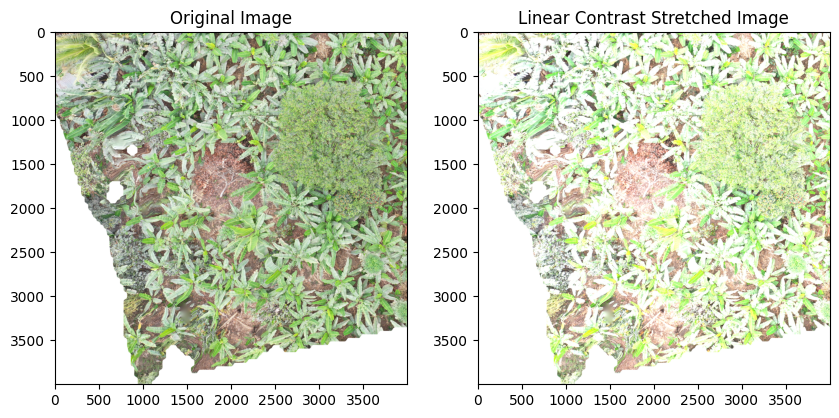

Original Metrics:
{'brightness': 178.3105091875, 'contrast': 54.49212693689779, 'edge_intensity': 2115309.0}
Enhanced Metrics:
{'brightness': 224.448815875, 'contrast': 44.37093002952888, 'edge_intensity': 1825280.0}


In [568]:
stretched = linear_contrast_stretching(test_image, alpha=1.5, beta=0)
display_images(test_image, stretched, 'Linear Contrast Stretched Image')

These metrics are not improving; will not use this filter 

### Sharpening

In [569]:
def unsharp_mask(img, sigma=1.0, strength=1.5):
    # Apply Gaussian blur to the image
    blurred = cv2.GaussianBlur(img, (0, 0), sigma)
    
    # Calculate the unsharp mask
    unsharp = cv2.addWeighted(img, 1 + strength, blurred, -strength, 0)
    
    return unsharp

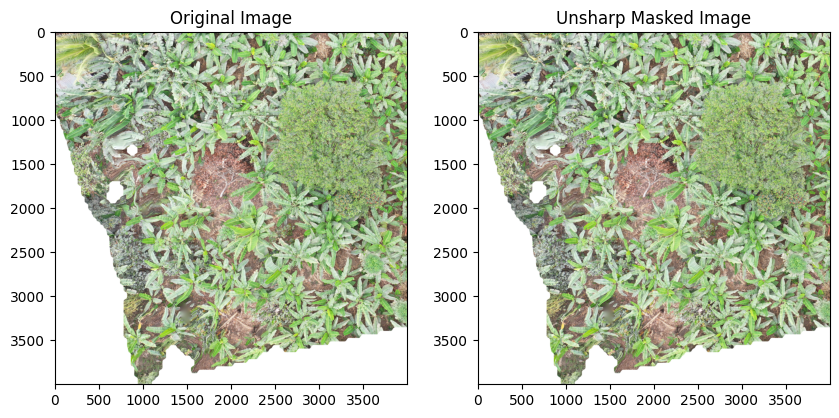

Original Metrics:
{'brightness': 178.3105091875, 'contrast': 54.49212693689779, 'edge_intensity': 2115309.0}
Enhanced Metrics:
{'brightness': 178.3105091875, 'contrast': 54.49212693689779, 'edge_intensity': 2115309.0}


In [570]:
sharpened_img = unsharp_mask(test_image, sigma=0.25, strength=3)
display_images(test_image, sharpened_img, 'Unsharp Masked Image')

This has done nothing; will not use this filter

In [571]:
def laplacian_sharpening(img):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Apply the Laplacian filter
    laplacian = cv2.Laplacian(gray, cv2.CV_64F)
    
    # Convert back to BGR
    laplacian = cv2.convertScaleAbs(laplacian)
    laplacian_bgr = cv2.cvtColor(laplacian, cv2.COLOR_GRAY2BGR)
    
    # Add the Laplacian result back to the original image
    sharpened = cv2.addWeighted(img, 1.0, laplacian_bgr, 1.0, 0)
    
    return sharpened

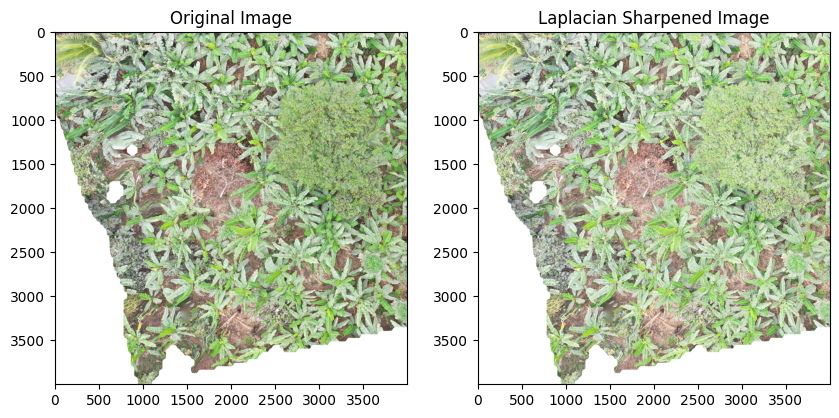

Original Metrics:
{'brightness': 178.3105091875, 'contrast': 54.49212693689779, 'edge_intensity': 2115309.0}
Enhanced Metrics:
{'brightness': 190.8981611875, 'contrast': 50.30058440683133, 'edge_intensity': 2448023.0}


In [572]:
laplacian = laplacian_sharpening(test_image)
display_images(test_image, laplacian, 'Laplacian Sharpened Image')

### Edge Detection

In [573]:
def sobel_edge_detection(img):
    # Convert the image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Compute the Sobel gradients
    sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)
    
    # Calculate the magnitude of the gradients
    sobel_magnitude = np.sqrt(sobel_x**2 + sobel_y**2)
    sobel_magnitude = cv2.convertScaleAbs(sobel_magnitude)
    
    return sobel_magnitude

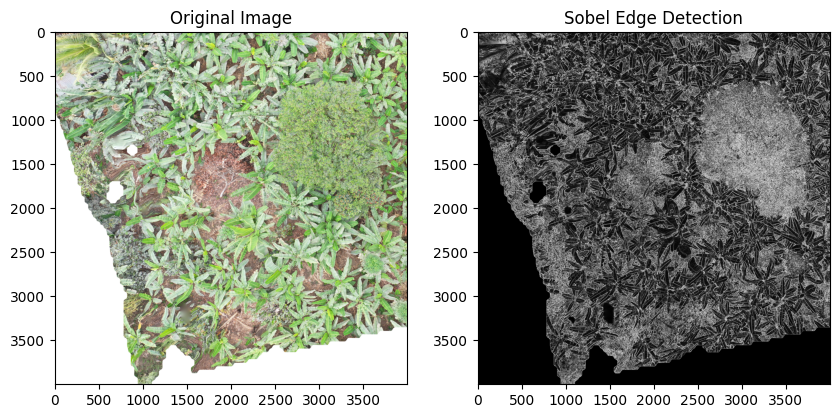

Original Metrics:
{'brightness': 178.3105091875, 'contrast': 54.49212693689779, 'edge_intensity': 2115309.0}


error: OpenCV(4.10.0) /Users/xperience/GHA-Actions-OpenCV/_work/opencv-python/opencv-python/opencv/modules/imgproc/src/color.simd_helpers.hpp:92: error: (-2:Unspecified error) in function 'cv::impl::(anonymous namespace)::CvtHelper<cv::impl::(anonymous namespace)::Set<3, 4, -1>, cv::impl::(anonymous namespace)::Set<1, -1, -1>, cv::impl::(anonymous namespace)::Set<0, 2, 5>, cv::impl::(anonymous namespace)::NONE>::CvtHelper(cv::InputArray, cv::OutputArray, int) [VScn = cv::impl::(anonymous namespace)::Set<3, 4, -1>, VDcn = cv::impl::(anonymous namespace)::Set<1, -1, -1>, VDepth = cv::impl::(anonymous namespace)::Set<0, 2, 5>, sizePolicy = cv::impl::(anonymous namespace)::NONE]'
> Invalid number of channels in input image:
>     'VScn::contains(scn)'
> where
>     'scn' is 1


In [574]:
sobel = sobel_edge_detection(test_image)
display_images(test_image, sobel, 'Sobel Edge Detection')

### Noise Reduction 

In [575]:
def denoise(img, kernel_size=3, strength=10):
    # Apply Gaussian blur to reduce noise
    blurred = cv2.GaussianBlur(img, (kernel_size, kernel_size), strength)
    return blurred

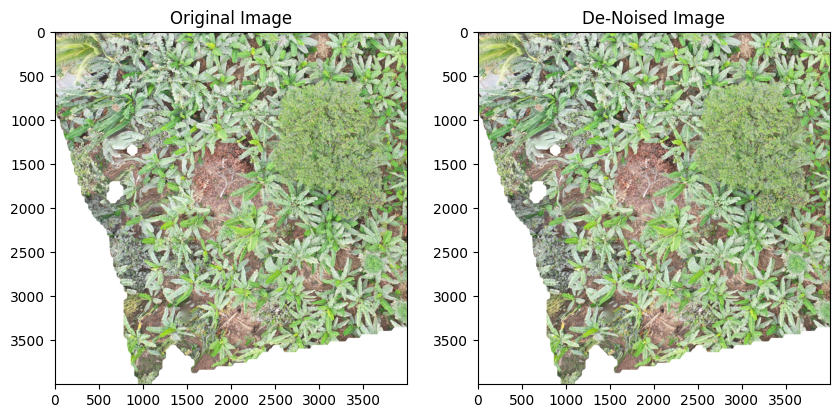

Original Metrics:
{'brightness': 178.3105091875, 'contrast': 54.49212693689779, 'edge_intensity': 2115309.0}
Enhanced Metrics:
{'brightness': 178.310638375, 'contrast': 52.94173996644785, 'edge_intensity': 1406542.0}


In [576]:
denoised = denoise(test_image)
display_images(test_image, denoised, 'De-Noised Image')

This did seem to make things worse, but could be a good first step. I will try with and without in my final enhancements. 

### Selecting final enhancements 

In [577]:
#function for applying all contrast enhancements
def selected_enhancements(img):
    histo = equalize_histogram(img)
    clahe_image = clahe(histo)
    gamma = gamma_correction(clahe_image, gamma=0.5)
    laplacian = laplacian_sharpening(gamma)
    
    return laplacian

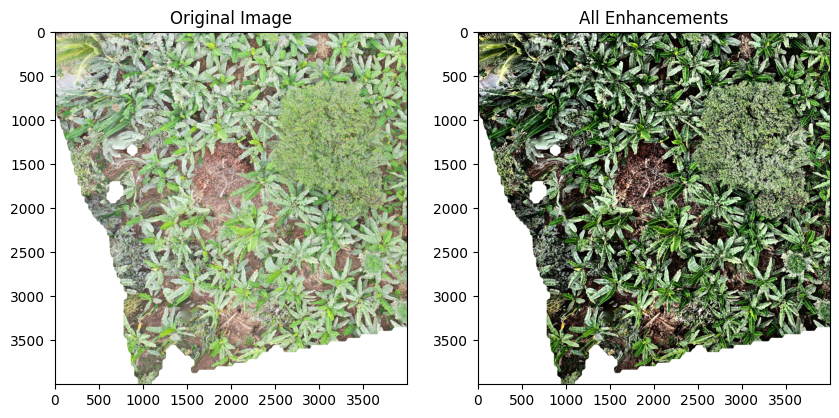

Original Metrics:
{'brightness': 178.3105091875, 'contrast': 54.49212693689779, 'edge_intensity': 2115309.0}
Enhanced Metrics:
{'brightness': 126.4885046875, 'contrast': 95.16300944620129, 'edge_intensity': 2882870.0}


In [578]:
all_enhanced = selected_enhancements(test_image)
display_images(test_image, all_enhanced, 'All Enhancements')

Edge intensity goes up markedly without denoising, so I will remove that 

**NB: I wonder if there is a way to do this more emperically rather than just visually**

#### Now that I have isolated the filters I want, I am going to apply them to 10 random images

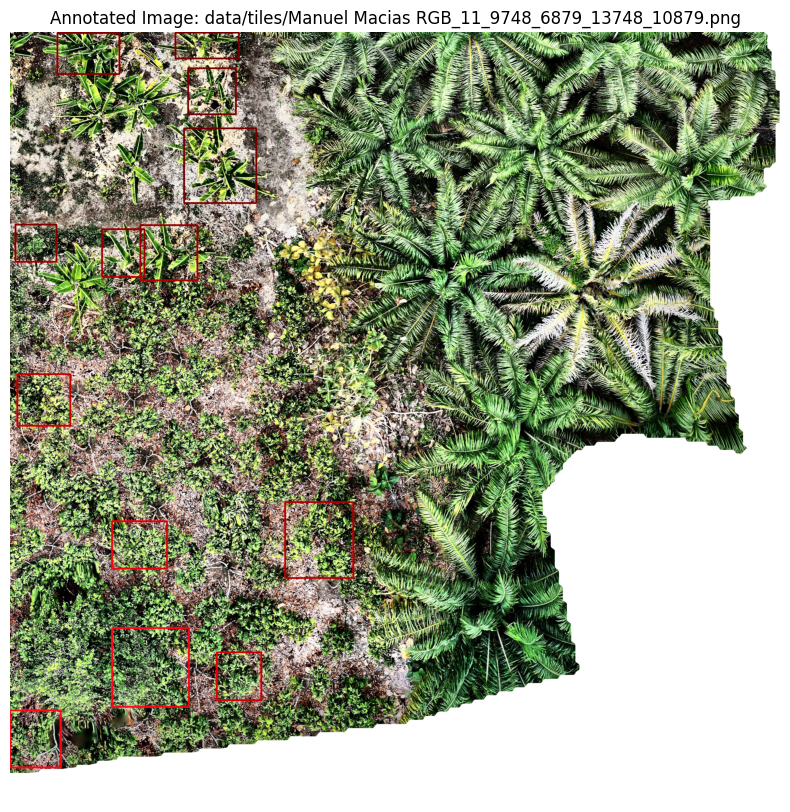

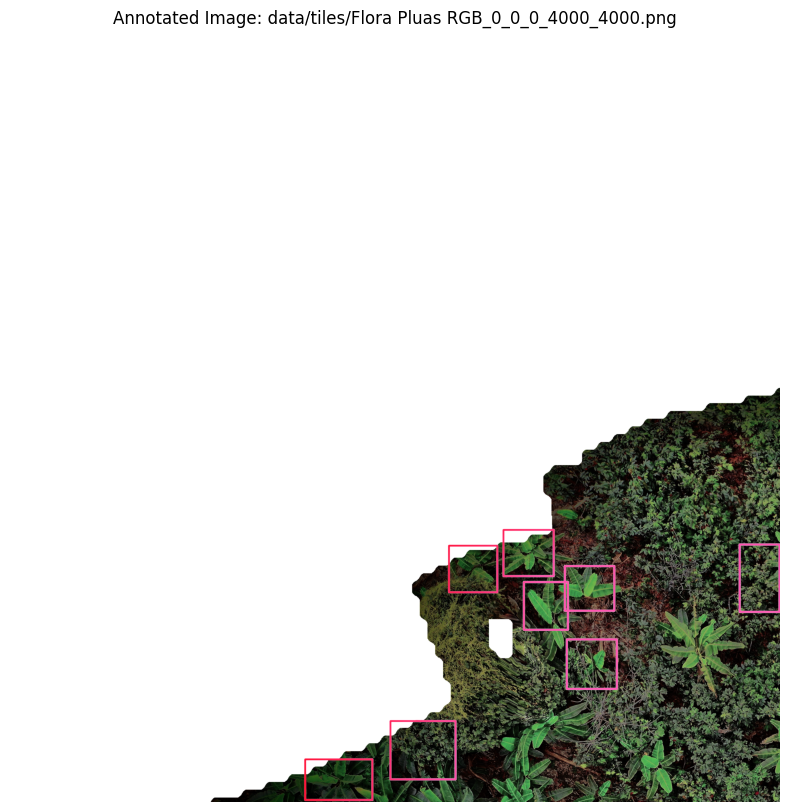

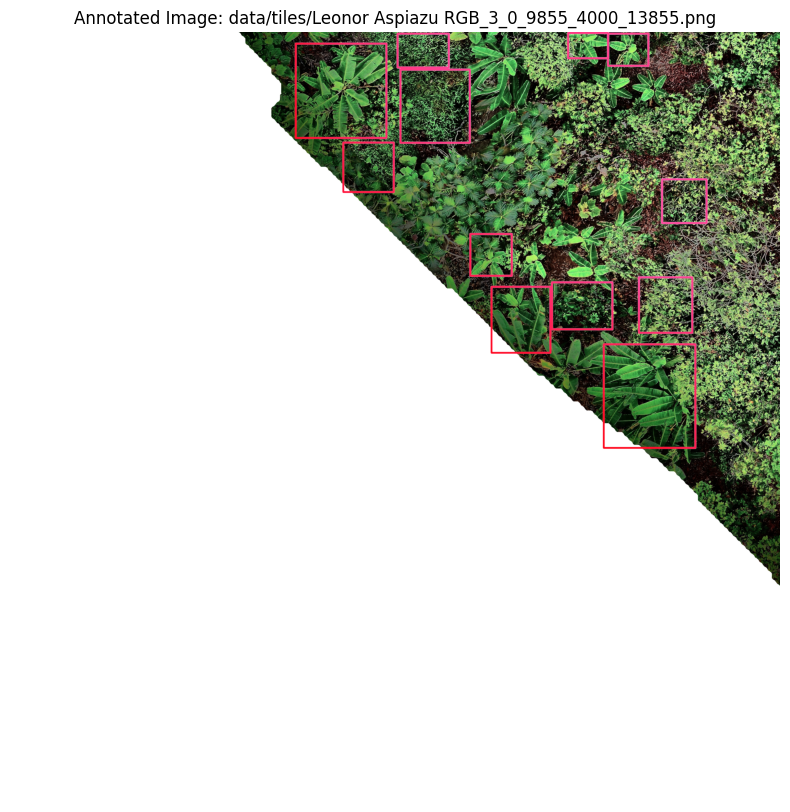

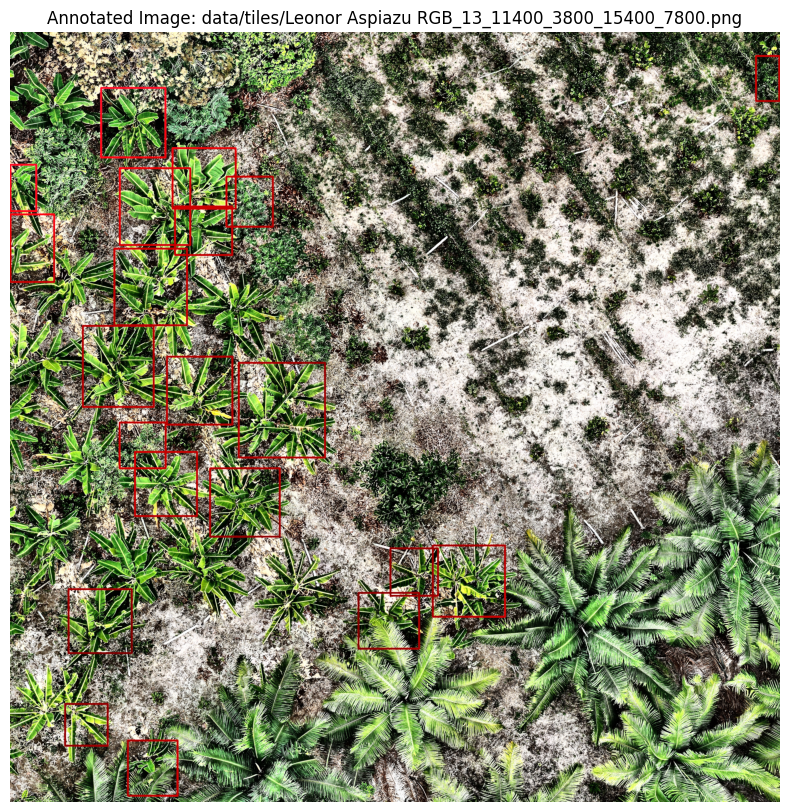

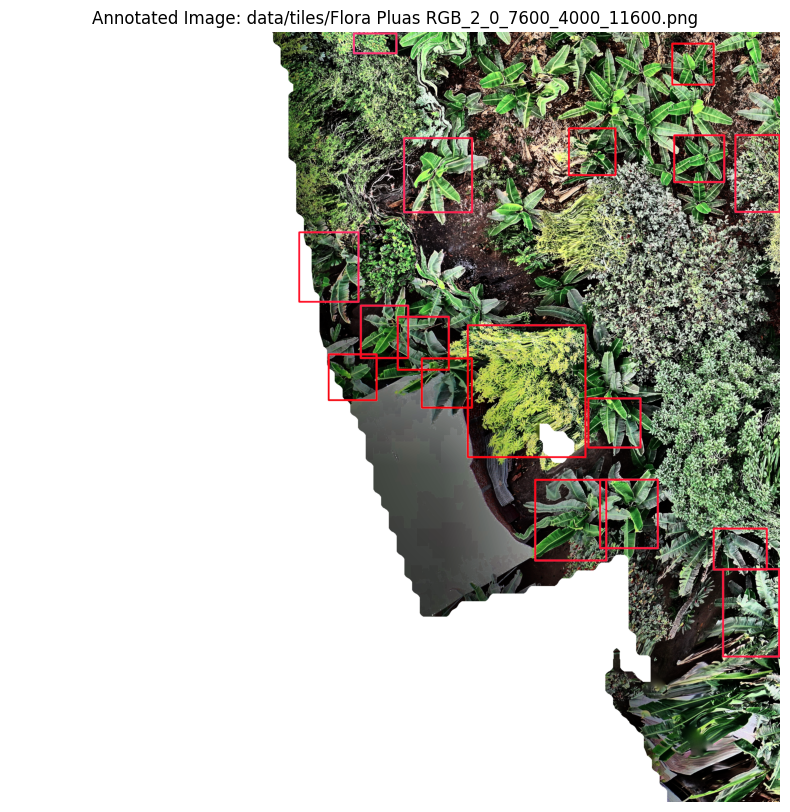

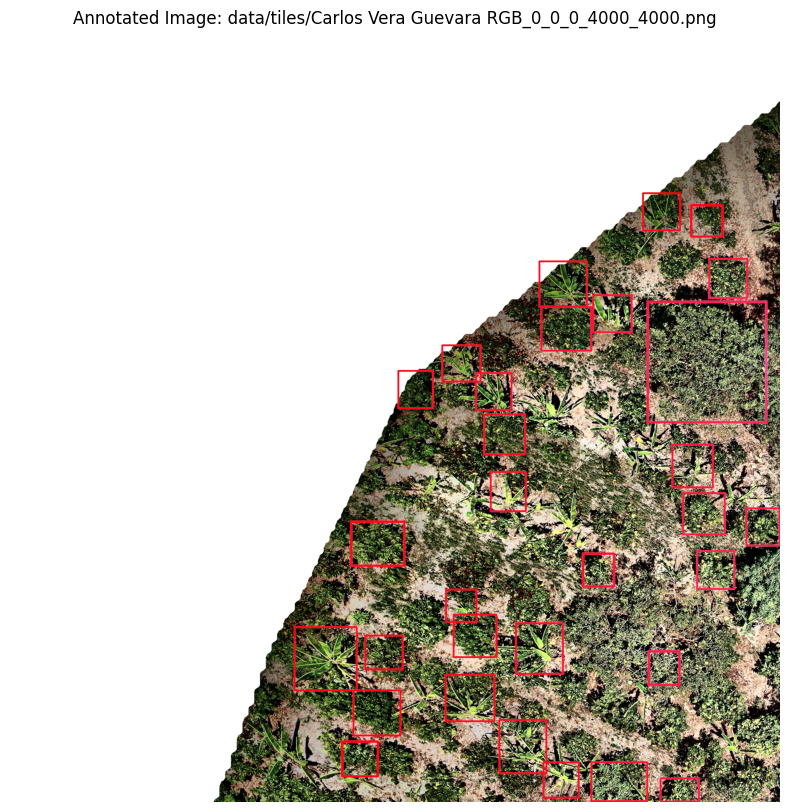

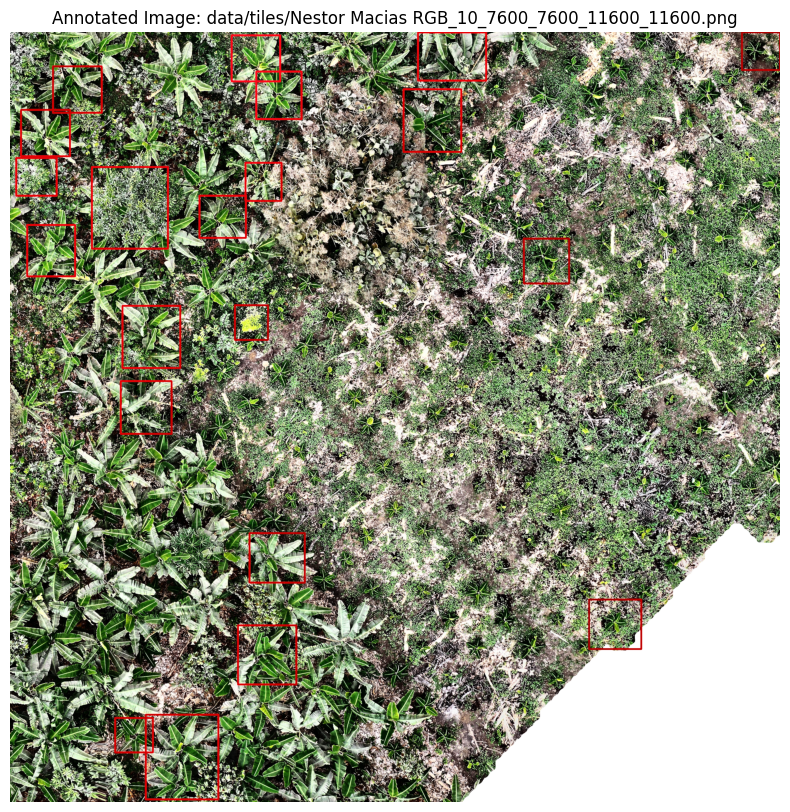

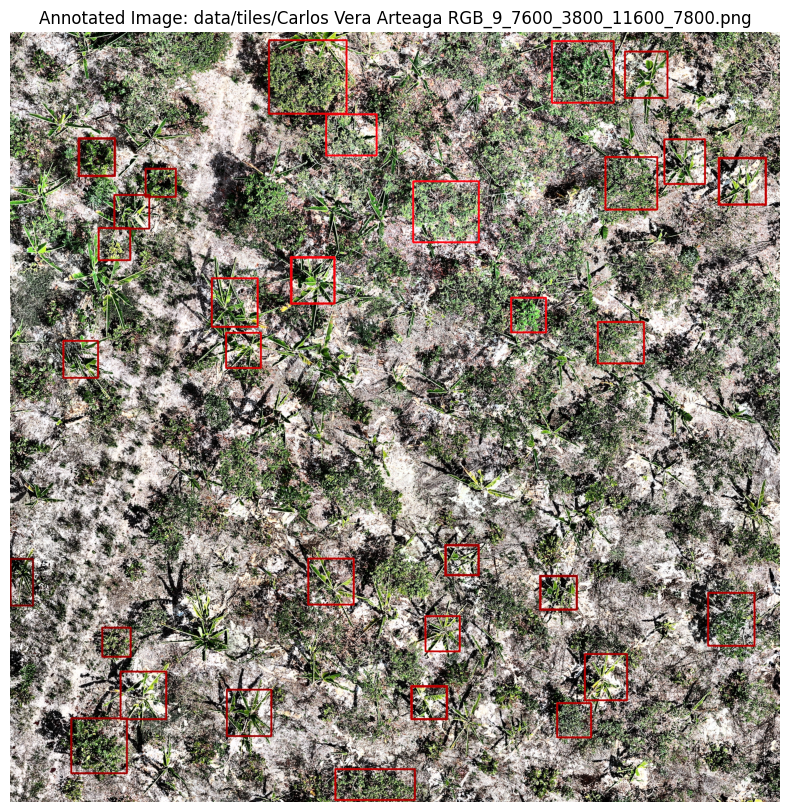

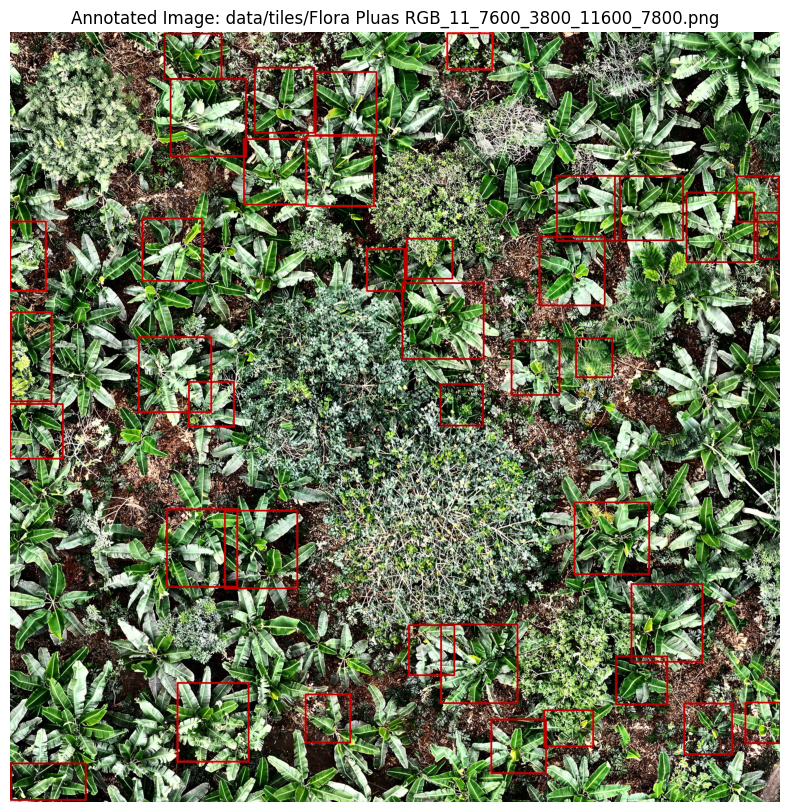

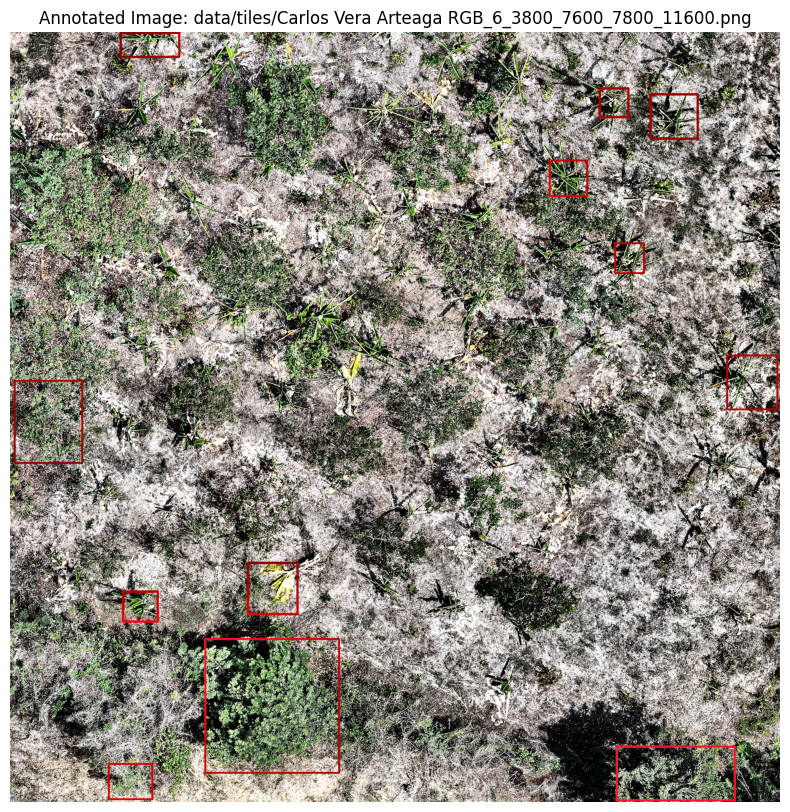

In [579]:
# Group the data by image
grouped = final_sm.groupby('img_path')

# Randomly sample 10 groups
sampled_groups = random.sample(list(grouped), 10)

# Iterate over each sampled group (each image) and draw bounding boxes
for img_path, group in sampled_groups:
    # Construct the full image path
    img_path = 'data/tiles/' + img_path
    
    bounding_boxes = group[['xmin', 'ymin', 'xmax', 'ymax']].to_dict('records')
    annotated_image = draw_bounding_boxes(img_path, bounding_boxes)
    enhanced_and_annotated_image = selected_enhancements(annotated_image)
    
    if annotated_image is not None:
        # Display the image with bounding boxes
        plt.figure(figsize=(10, 10))
        plt.imshow(enhanced_and_annotated_image)
        plt.title(f"Annotated Image: {img_path}")
        plt.axis('off')
        plt.show()

**NB: This is a document I can come back to; ultimately I will want to make this a .py file and just apply the enhancements at the start of my model code**

For now, I am happy with how this has enhanced the images. It will be interesting to see if it improves the model at all. 

### Filter out images containing more than 80% white area 

In [580]:
#function to check if an image has >80% white area 
def white_area_checker(img, threshold=80):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Threshold the image
    _, binary = cv2.threshold(gray, 250, 255, cv2.THRESH_BINARY)
    
    # Calculate the percentage of white pixels
    white_area = (np.sum(binary == 255) / binary.size) * 100
    
    return white_area > threshold

In [581]:
for img_path in final_sm['img_path'].unique():
    img_path = 'data/tiles/' + img_path
    img = cv2.imread(img_path)
    
    if white_area_checker(img):
        print(f"Image at {img_path} has more than 80% white area.")
    else:
        continue

Image at data/tiles/Flora Pluas RGB_18_11400_11400_15400_15400.png has more than 80% white area.
Image at data/tiles/Flora Pluas RGB_19_11400_11578_15400_15578.png has more than 80% white area.
Image at data/tiles/Leonor Aspiazu RGB_15_11400_9855_15400_13855.png has more than 80% white area.
Image at data/tiles/Nestor Macias RGB_15_11003_9024_15003_13024.png has more than 80% white area.
Image at data/tiles/Nestor Macias RGB_0_0_0_4000_4000.png has more than 80% white area.
Image at data/tiles/Carlos Vera Arteaga RGB_15_11297_11053_15297_15053.png has more than 80% white area.
Image at data/tiles/Leonor Aspiazu RGB_19_13134_9855_17134_13855.png has more than 80% white area.


Looking at the images that are said to have more than 80% white area

In [582]:
image_1 = cv2.imread('data/tiles/Flora Pluas RGB_18_11400_11400_15400_15400.png')
image_2 = cv2.imread('data/tiles/Flora Pluas RGB_19_11400_11578_15400_15578.png')
image_3 = cv2.imread('data/tiles/Leonor Aspiazu RGB_15_11400_9855_15400_13855.png')
image_4 = cv2.imread('data/tiles/Nestor Macias RGB_15_11003_9024_15003_13024.png')
image_5 = cv2.imread('data/tiles/Nestor Macias RGB_0_0_0_4000_4000.png')
image_6 = cv2.imread('data/tiles/Carlos Vera Arteaga RGB_15_11297_11053_15297_15053.png')
image_7 = cv2.imread('data/tiles/Leonor Aspiazu RGB_19_13134_9855_17134_13855.png')

images = [image_1, image_2, image_3, image_4, image_5, image_6, image_7]

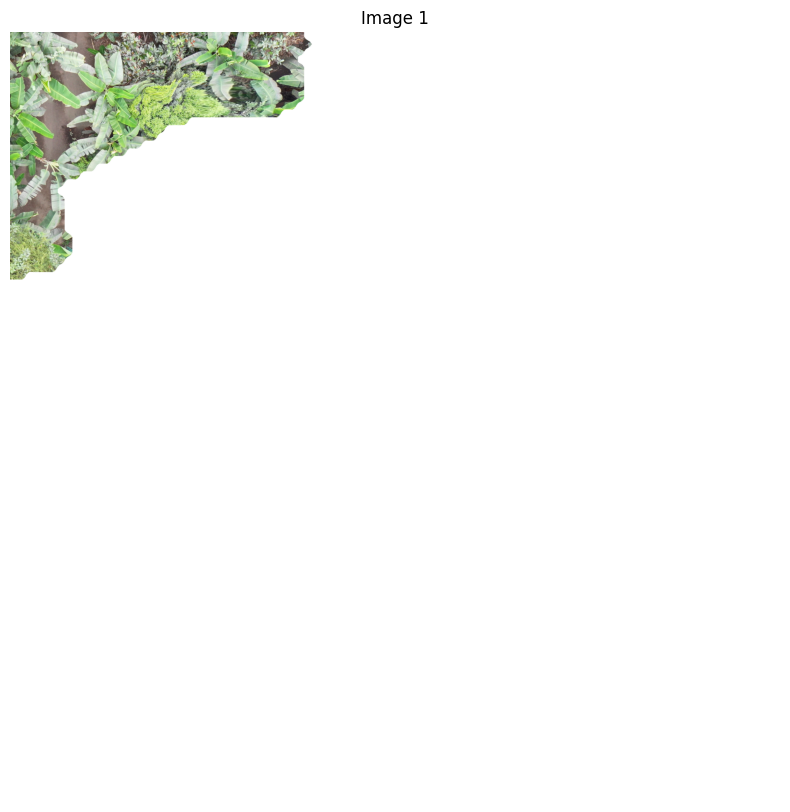

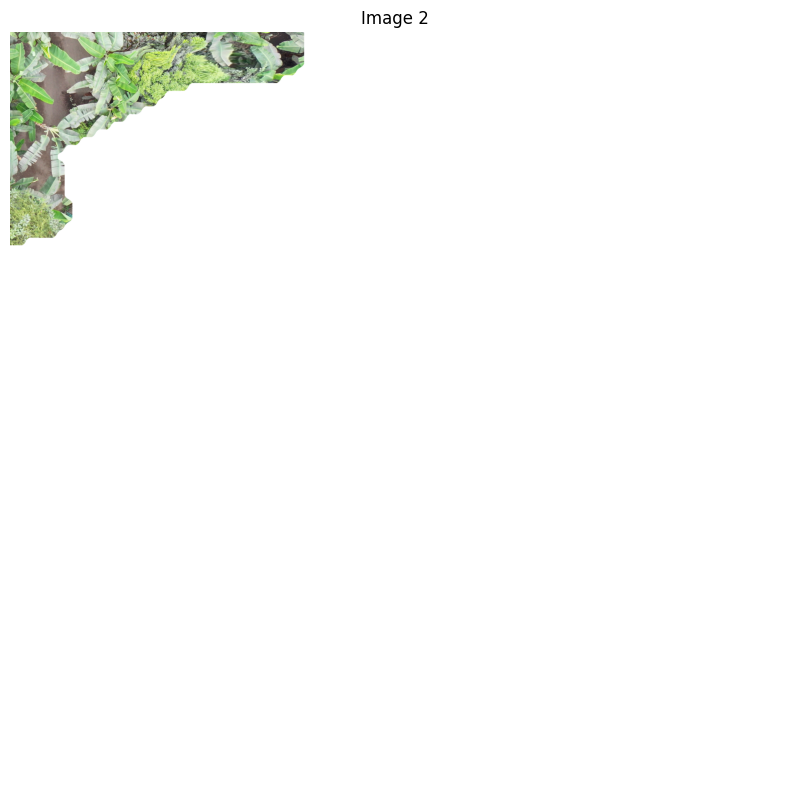

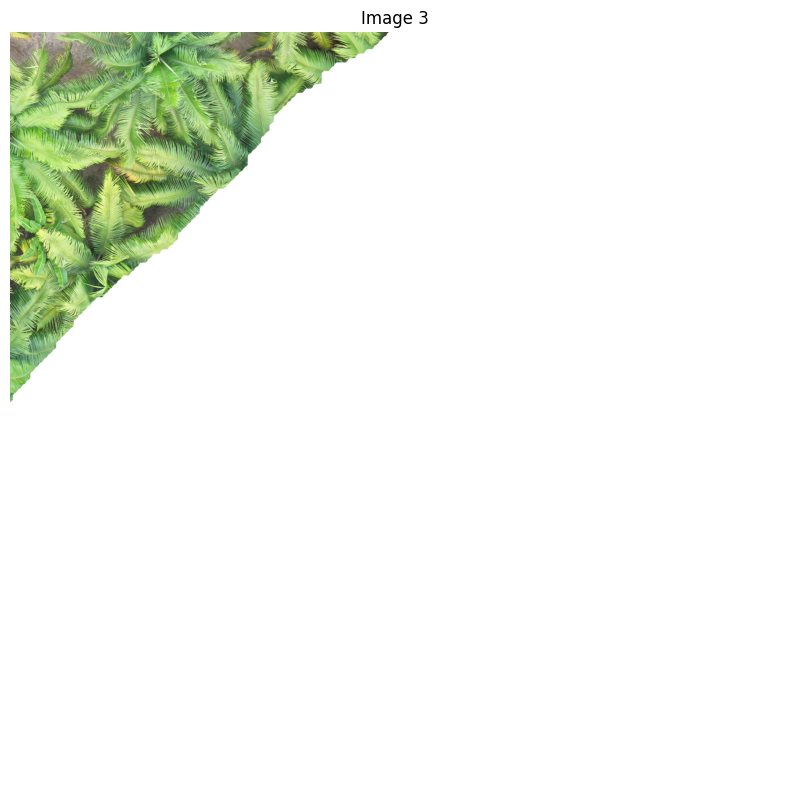

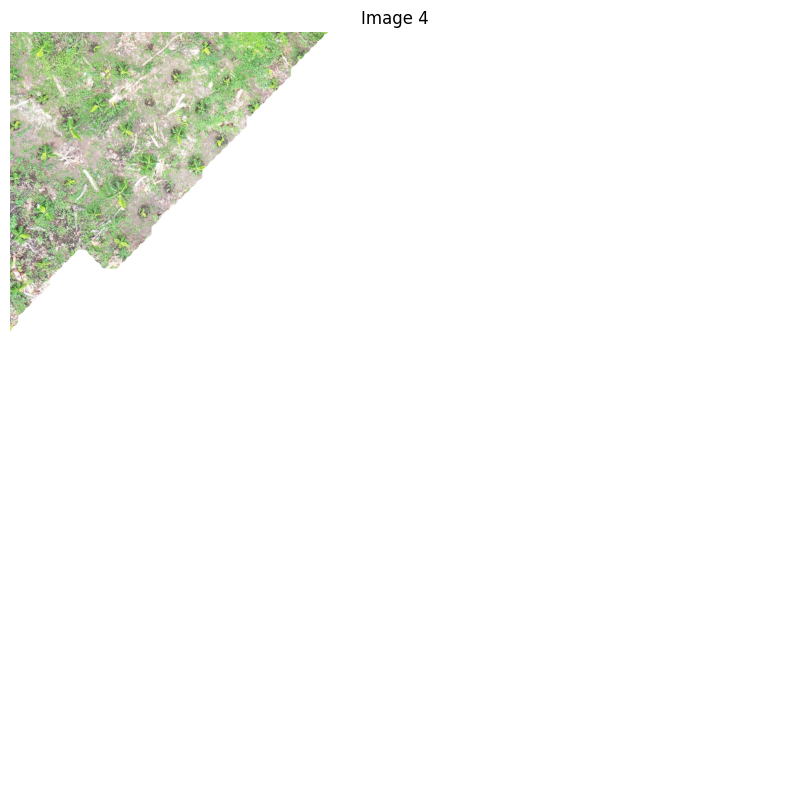

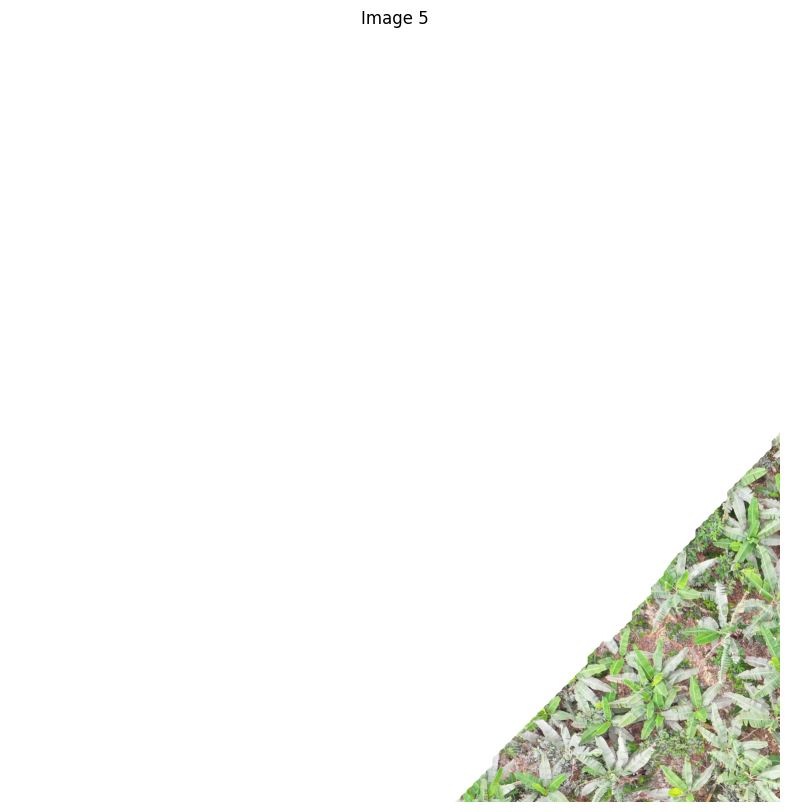

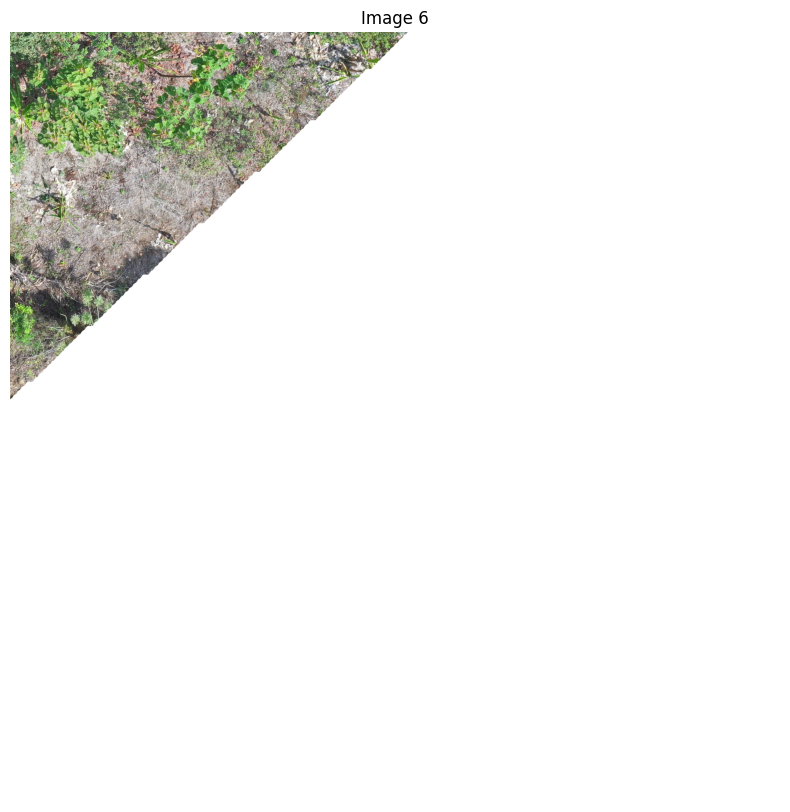

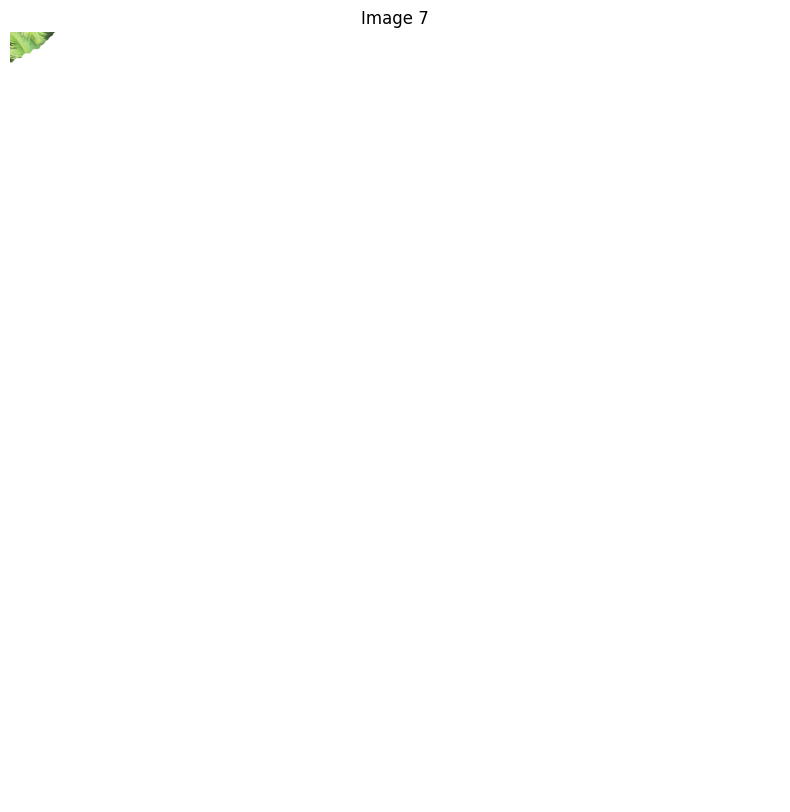

In [583]:
#use for loop to plot the images 
for i, img in enumerate(images):
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title(f"Image {i + 1}")
    plt.axis('off')
    plt.show()

**Confirmed that I feel comfortable removing these from the dataset**

In [584]:
#function to remove images with >80% white area from the dataset 

def remove_white_area_images(df):
    to_remove = []
    # Group the data by image
    grouped = df.groupby('img_path')
    
    # Iterate over each group (each image) and check for white area
    for img_path, group in grouped:
        img_path_full = 'data/tiles/' + img_path
        img = cv2.imread(img_path_full)
        
        if white_area_checker(img):
            print(f"Image at {img_path_full} has more than 80% white area. Removing from dataset.")
            to_remove.append(img_path)

    df = df[~df['img_path'].isin(to_remove)]
    
    return df

In [585]:
final_sm = remove_white_area_images(final_sm)

Image at data/tiles/Carlos Vera Arteaga RGB_15_11297_11053_15297_15053.png has more than 80% white area. Removing from dataset.
Image at data/tiles/Flora Pluas RGB_18_11400_11400_15400_15400.png has more than 80% white area. Removing from dataset.
Image at data/tiles/Flora Pluas RGB_19_11400_11578_15400_15578.png has more than 80% white area. Removing from dataset.
Image at data/tiles/Leonor Aspiazu RGB_15_11400_9855_15400_13855.png has more than 80% white area. Removing from dataset.
Image at data/tiles/Leonor Aspiazu RGB_19_13134_9855_17134_13855.png has more than 80% white area. Removing from dataset.
Image at data/tiles/Nestor Macias RGB_0_0_0_4000_4000.png has more than 80% white area. Removing from dataset.
Image at data/tiles/Nestor Macias RGB_15_11003_9024_15003_13024.png has more than 80% white area. Removing from dataset.


In [586]:
final_sm.shape

(2602, 43)

## Save processed images and final dataset 

In [587]:
#save final_sm as a separate csv file
final_sm.to_csv('final_dataset_filtered.csv', index=False)

In [588]:
#go through all images and apply the selected enhancements
def apply_enhancements(df):
    for img_path in df['img_path'].unique():
        img_path_full = 'data/tiles/' + img_path
        img = cv2.imread(img_path_full)

        enhanced_img = selected_enhancements(img)
        
        # Save the enhanced image in a folder
        enhanced_img_path = 'data/tiles/processed/' + img_path
        cv2.imwrite(enhanced_img_path, enhanced_img)

In [589]:
apply_enhancements(final_sm)